### Import libraries

In [ ]:
from fish_eeg.constants import sampling_frequency
from fish_eeg.data import load_data
from fish_eeg.preprocess import Preprocessor
from fish_eeg.denoisers import Denoiser
from fish_eeg.filters import Filter
from fish_eeg.plotting import (
    plot_waveforms, 
    plot_fft,
    Plotter,
    plot_compare_denoised_waveform,
    plot_compare_denoised_fft,
    plot_bootstrap_fft_comparison,
    plot_doub_freq_hist,
)
from fish_eeg.fft import FFT
from fish_eeg.reconstruct import Reconstructor
from fish_eeg.utils import (separate_periods,collapse_channels,select_doub_freq_bin,dotdict)
from fish_eeg.statistics import Bootstrap
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np


In [ ]:
import yaml
from pathlib import Path

In [ ]:
pipeline_config_path = Path("/net/noble/vol3/user/ssontha2/classes/CSE583/fish_eeg/src/fish_eeg/configs/base_config.yaml")
with pipeline_config_path.open("r") as f:
    pipeline_config = yaml.safe_load(f)

In [ ]:
from fish_eeg.data import ConfigAccessor
from fish_eeg.data import PipelineConfig
pipeline_config = PipelineConfig(pipeline_config)
pipeline_config = ConfigAccessor(pipeline_config)
pipeline_config

### 1. Load data

In [ ]:
path = '/net/noble/vol3/user/ssontha2/classes/CSE583/fish_eeg/data'
subjid = 'hydrolagusColliei_8'
eegdataset= load_data(path, subjid)

### 2. Preprocess

In [ ]:
preprocessor = Preprocessor(eegdataset,pipeline_config)
eegdataset = preprocessor.pipeline()


#### Plot waveform!
##### use standalone functions to plot for a single freq/amp combo

(<Figure size 400x400 with 4 Axes>,
 array([<Axes: ylabel='ch1'>, <Axes: ylabel='ch2'>, <Axes: ylabel='ch3'>,
        <Axes: ylabel='ch4'>], dtype=object))

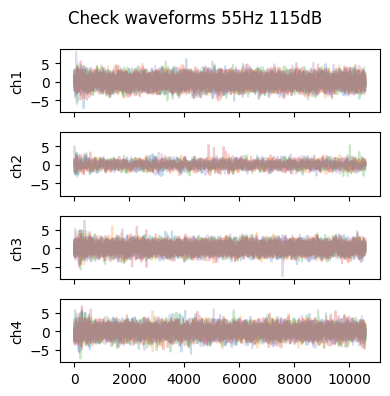

In [7]:
#### use standalone plot_waveforms to plot single freq,amp combo!!s
plot_waveforms(eegdataset.rms_subsampled_data[(55,115)], eegdataset.channel_keys, 
               title=f'Check waveforms {55}Hz {115}dB', num_samples=5, figsize=(4, 4), alpha=0.25)

##### use Plotter class to make big grid plots for all freq/amp combo


/net/noble/vol3/user/ssontha2/classes/CSE583/fish_eeg/src/fish_eeg/plotting.py:961: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


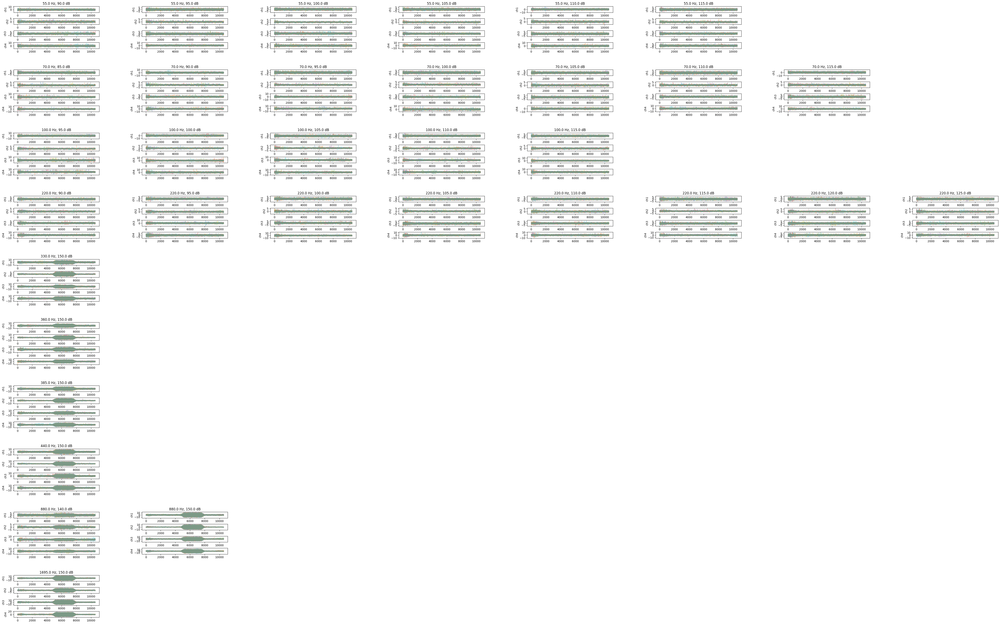

In [8]:
#### big plot for all freqs and amps for a global view
Plotter(eegdataset).plot_waveforms_by_frequency_rows(save_path="yash_plots/preprocess",channel_keys=eegdataset.channel_keys)

### 3. Bandpass filter

In [ ]:
filter = Filter(eegdataset,pipeline_config)
eegdataset = filter.pipeline()

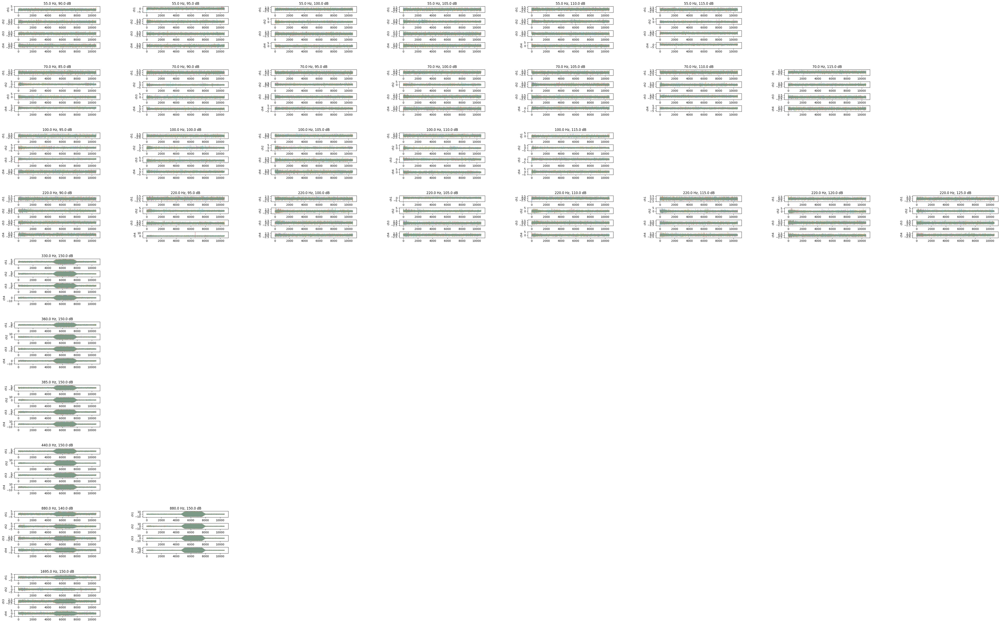

In [10]:
#### big plot for all freqs and amps for a global view
Plotter(eegdataset).plot_waveforms_by_frequency_rows(attr="bandpass_data",channel_keys=eegdataset.channel_keys,save_path="yash_plots/bandpass_data")

(<Figure size 400x400 with 4 Axes>,
 array([<Axes: ylabel='ch1'>, <Axes: ylabel='ch2'>, <Axes: ylabel='ch3'>,
        <Axes: ylabel='ch4'>], dtype=object))

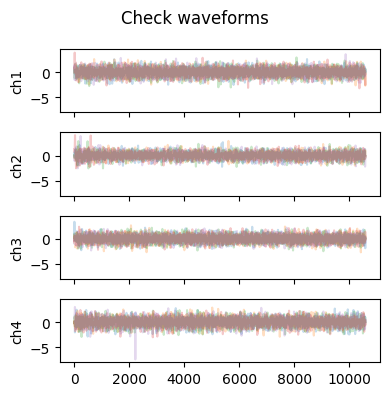

In [11]:
plot_waveforms(eegdataset.bandpass_data[(55,115)], eegdataset.channel_keys, 
               title='Check waveforms', num_samples=5, figsize=(4, 4), alpha=0.25)

### 4. Denoise

In [ ]:
denoiser = Denoiser(eegdataset,pipeline_config)
eegdataset =denoiser.pipeline()

Elapsed time: 0.60 seconds
ICA Convergence: 9
Elapsed time: 0.22 seconds
ICA Convergence: 6
Elapsed time: 0.57 seconds
ICA Convergence: 11
Elapsed time: 0.68 seconds
ICA Convergence: 13
Elapsed time: 1.32 seconds
ICA Convergence: 9


Elapsed time: 0.44 seconds
ICA Convergence: 10
Elapsed time: 0.49 seconds
ICA Convergence: 7
Elapsed time: 0.30 seconds
ICA Convergence: 11
Elapsed time: 0.71 seconds
ICA Convergence: 14
Elapsed time: 1.15 seconds
ICA Convergence: 10
Elapsed time: 0.33 seconds
ICA Convergence: 5
Elapsed time: 0.76 seconds
ICA Convergence: 7
Elapsed time: 2.31 seconds
ICA Convergence: 6
Elapsed time: 2.79 seconds
ICA Convergence: 49
Elapsed time: 0.75 seconds
ICA Convergence: 7
Elapsed time: 0.27 seconds
ICA Convergence: 10
Elapsed time: 1.18 seconds
ICA Convergence: 6
Elapsed time: 0.88 seconds
ICA Convergence: 5
Elapsed time: 1.15 seconds
ICA Convergence: 6
Elapsed time: 1.22 seconds
ICA Convergence: 6
Elapsed time: 1.47 seconds
ICA Convergence: 9
Elapsed time: 3.46 seconds
ICA Convergence: 12
Elapsed time: 3.73 seconds
ICA Convergence: 13
Elapsed time: 2.49 seconds
ICA Convergence: 19
Elapsed time: 3.00 seconds
ICA Convergence: 10
Elapsed time: 0.54 seconds
ICA Convergence: 8
Elapsed time: 0.25 secon

(<Figure size 400x400 with 4 Axes>,
 array([<Axes: ylabel='col0'>, <Axes: ylabel='col1'>,
        <Axes: ylabel='col2'>, <Axes: ylabel='col3'>], dtype=object))

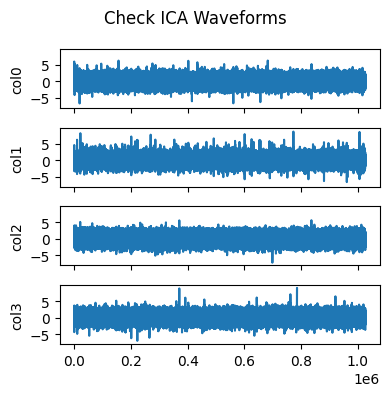

In [ ]:
plot_waveforms(eegdataset.ica_output[(55,115)]['S'], [], 
               title='Check ICA Waveforms', num_samples=[], figsize=(4, 4), alpha=1.0)

In [ ]:
#### big plot for all freqs and amps for a global view
Plotter(eegdataset).plot_waveforms_by_frequency_rows(attr="ica_output",channel_keys=[],num_samples=[],save_path="yash_plots/ICA_plots")

/net/noble/vol3/user/ssontha2/classes/CSE583/fish_eeg/src/fish_eeg/plotting.py:1035: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


### 5. FFT

In [ ]:
fft = FFT(eegdataset,pipeline_config)
eegdataset = fft.pipeline(sampling_frequency)

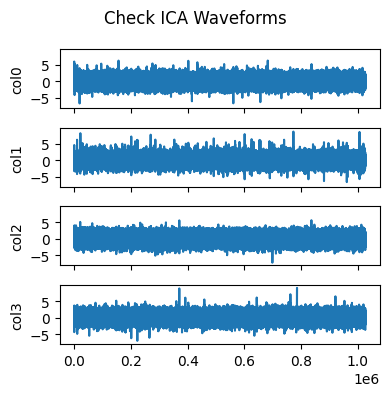

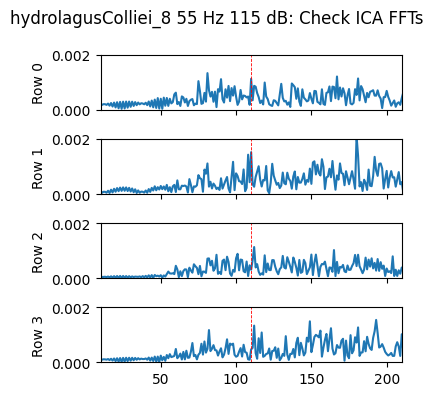

In [ ]:
plot_waveforms(eegdataset.ica_output[(55,115)]['S'], channel_keys=[], 
               title='Check ICA Waveforms', num_samples=[], figsize=(4, 4), alpha=1.0)
plot_fft(eegdataset.ica_fft_output[(55,115)][0], eegdataset.ica_fft_output[(55,115)][1], 55, 115, subjid, 0, channel_keys=[], period_keys=[],
         title='Check ICA FFTs', num_samples=5, figsize=(4, 4), alpha=1.0,xlim=[55*2-100,55*2+100], ylim=[0,0.002])


/net/noble/vol3/user/ssontha2/classes/CSE583/fish_eeg/src/fish_eeg/plotting.py:1026: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  


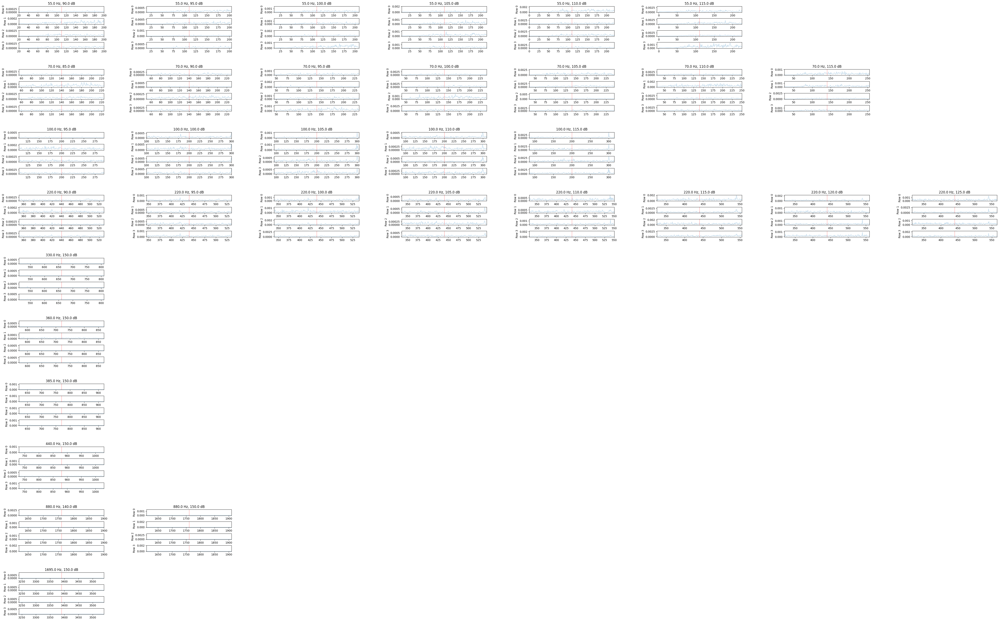

In [ ]:
#### big plot for all freqs and amps for a global view
Plotter(eegdataset).plot_fft_all_ica(attr="ica_fft_output",
channel_keys=[],
period_keys=[],
save_path="yash_plots/FFT",subjid=subjid,dataset_index=0)

### 6. Reconstruct

In [ ]:
reconstructor = Reconstructor(eegdataset,pipeline_config)
eegdataset =reconstructor.pipeline(weighted=False)

TypeError: dict.get() takes no keyword arguments

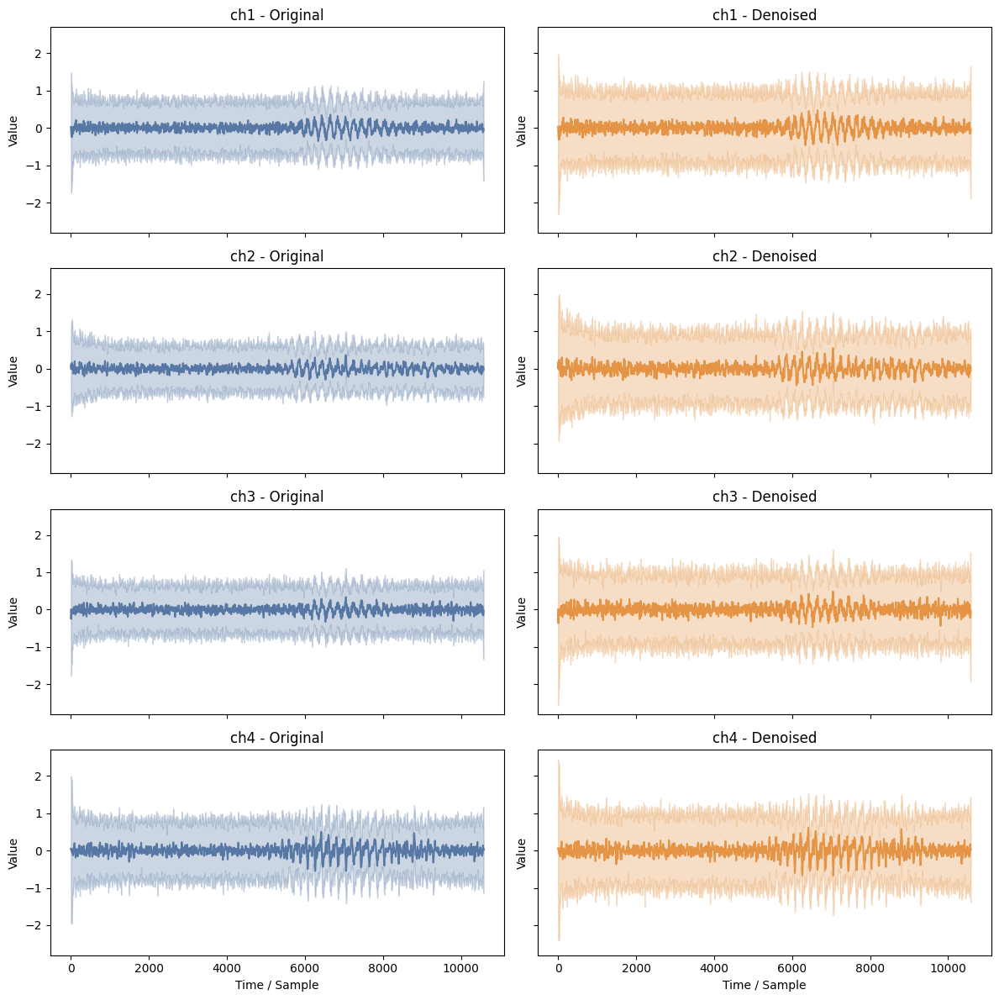

In [ ]:
plot_compare_denoised_waveform(eegdataset.reconstructed_ica_data[(55,115)]['compare_denoising_mean'],
eegdataset.reconstructed_ica_data[(55,115)]['compare_denoising_std'],
eegdataset.channel_keys)

In [ ]:
Plotter(eegdataset).plot_compare_denoised_by_frequency_rows(attr="reconstructed_ica_data")

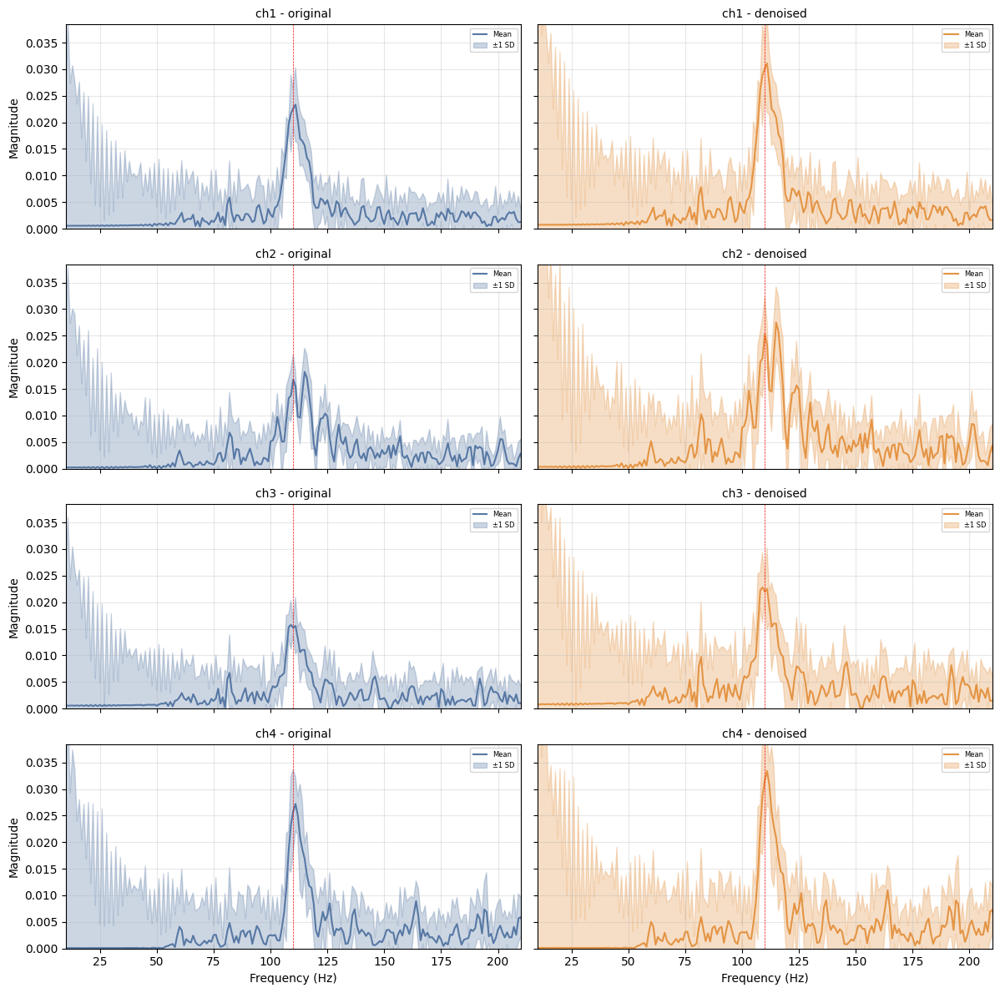

In [ ]:
plot_compare_denoised_fft(eegdataset.reconstructed_ica_data[(55,115)]['fft_freq_vecs'],
eegdataset.reconstructed_ica_data[(55,115)]['fft_magnitudes_mean'],
eegdataset.reconstructed_ica_data[(55,115)]['fft_magnitudes_std'],eegdataset.channel_keys,55,115)

In [ ]:
Plotter(eegdataset).plot_compare_denoised_fft_by_frequency_rows()

(<Figure size 12000x10000 with 311 Axes>, GridSpec(10, 8))

### 7. Compute FFT per reconstructed data stim on/off periods  

In [ ]:
eegdataset = separate_periods(eegdataset)

In [ ]:
fft = FFT(eegdataset)
eegdataset = fft.pipeline(sampling_frequency)

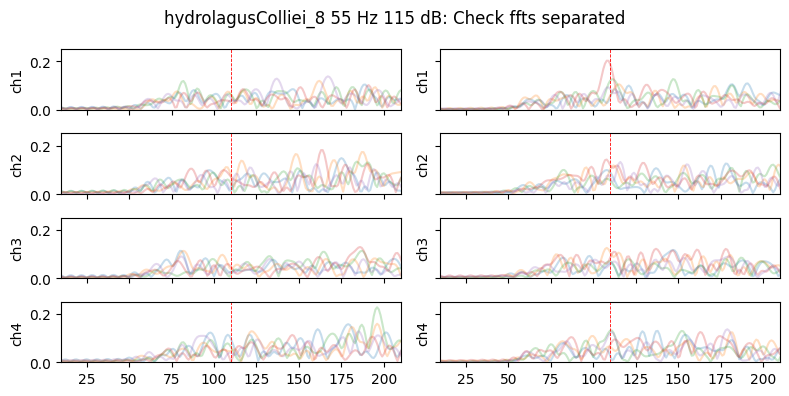

In [ ]:
plot_fft(eegdataset.reconstructed_ica_fft_output[(55,115)][0], eegdataset.reconstructed_ica_fft_output[(55,115)][1], 55, 115, subjid, 0, channel_keys = eegdataset.channel_keys,
            period_keys=eegdataset.period_keys, 
            title='Check ffts separated', 
            num_samples=5, 
            figsize=(8, 4), 
            alpha=0.25,
            xlim=[55*2-100,55*2+100],
            ylim=[0,0.25]
)

/net/noble/vol3/user/ssontha2/classes/CSE583/fish_eeg/src/fish_eeg/plotting.py:790: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


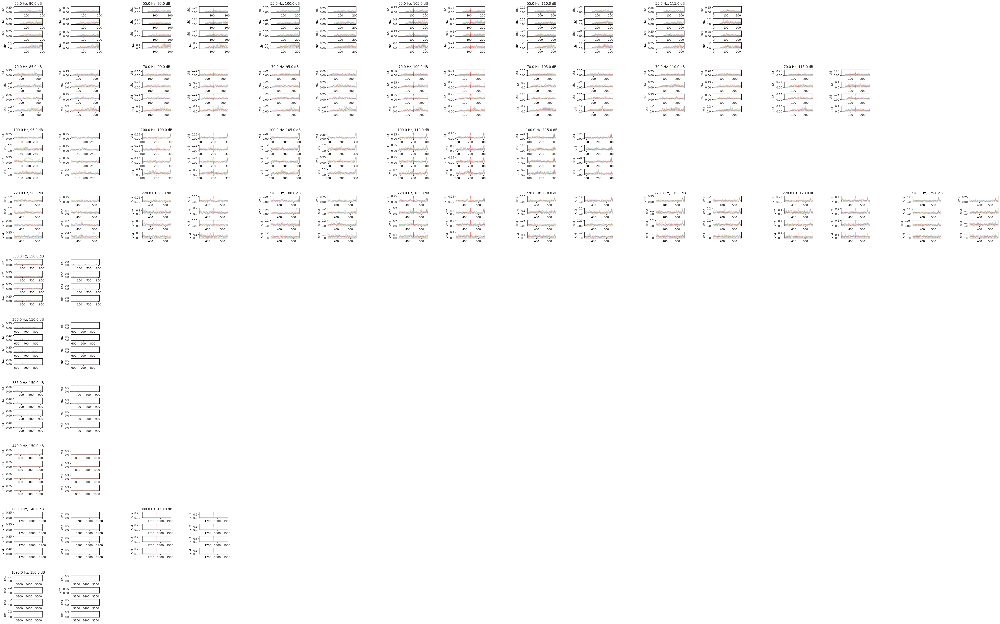

In [ ]:
#### big plot for all freqs and amps for a global view
Plotter(eegdataset).plot_fft_all_ica(attr="reconstructed_ica_fft_output",
channel_keys=eegdataset.channel_keys,
period_keys=eegdataset.period_keys,
save_path="yash_plots/reconstructedFFT",subjid=subjid,dataset_index=0)

### 8. Compute Bootstrap means 

In [ ]:
eegdataset = collapse_channels(eegdataset)
bootstrap = Bootstrap(eegdataset)
eegdataset = bootstrap.pipeline(n_iterations=100, random_state=42)


In [ ]:
bootstrap_means = eegdataset.bootstrap_data[55,115]['bootstrap_means']
bootstrap_stds = eegdataset.bootstrap_data[55,115]['bootstrap_std']
freq_vec = eegdataset.reconstructed_ica_fft_output[55,115][1]
coord = (55,115)

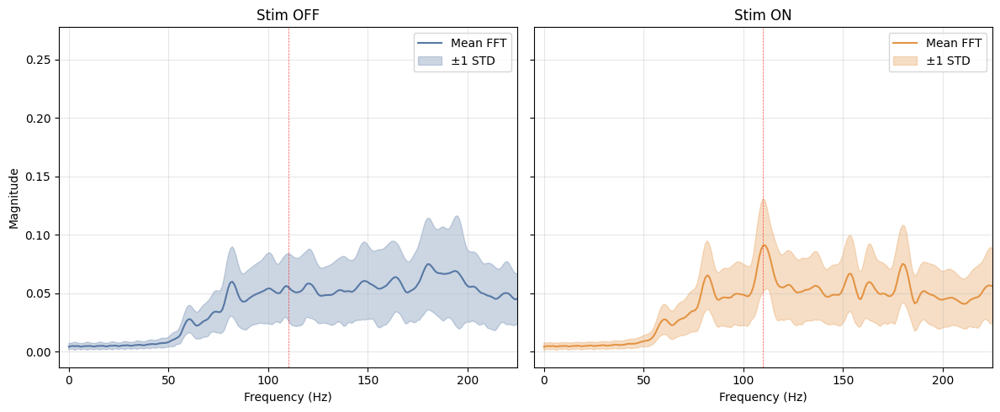

In [ ]:
plot_bootstrap_fft_comparison(bootstrap_means,bootstrap_stds,freq_vec,55,115,subjid,0)

(<Figure size 4800x4000 with 113 Axes>, GridSpec(10, 8))

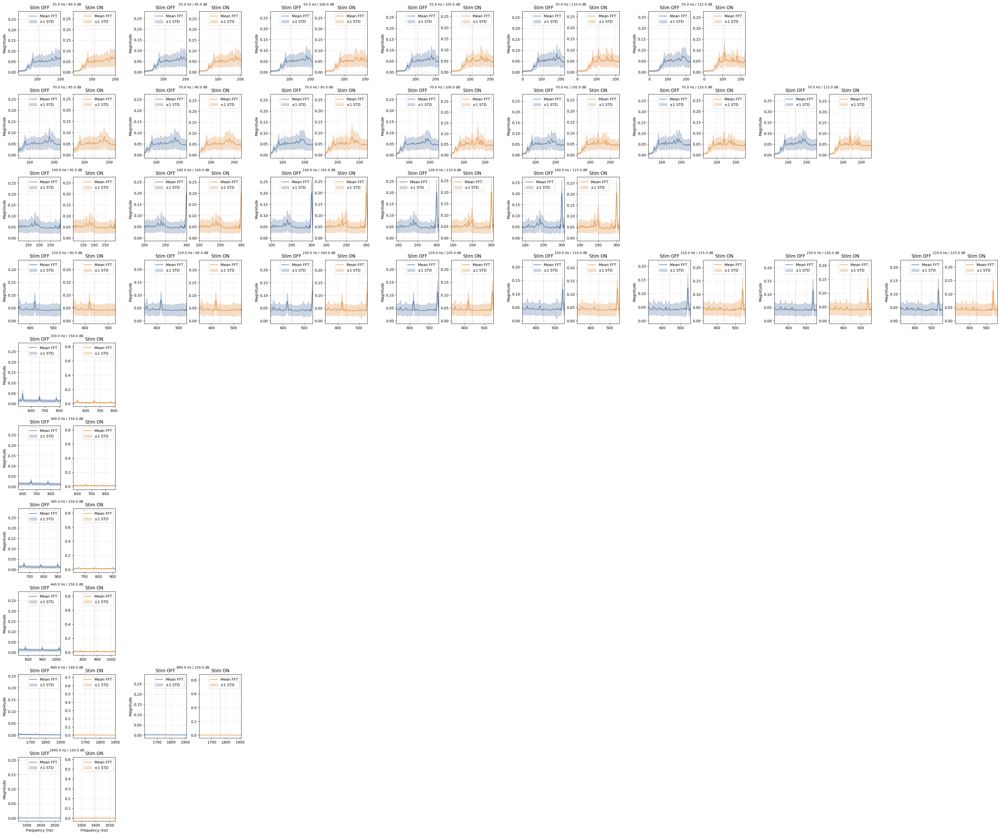

In [ ]:
Plotter(eegdataset).plot_bootstrap_fft_comparison_by_frequency_rows()

In [ ]:
doub_freq_dict = select_doub_freq_bin(bootstrap_means, freq_vec, eegdataset.period_keys, coord[0], window_size=100)

(97, 11026)
[107. 108. 109. 110. 111. 112. 113.]
(11026,)
[ 64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 114. 115. 116. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.]
100


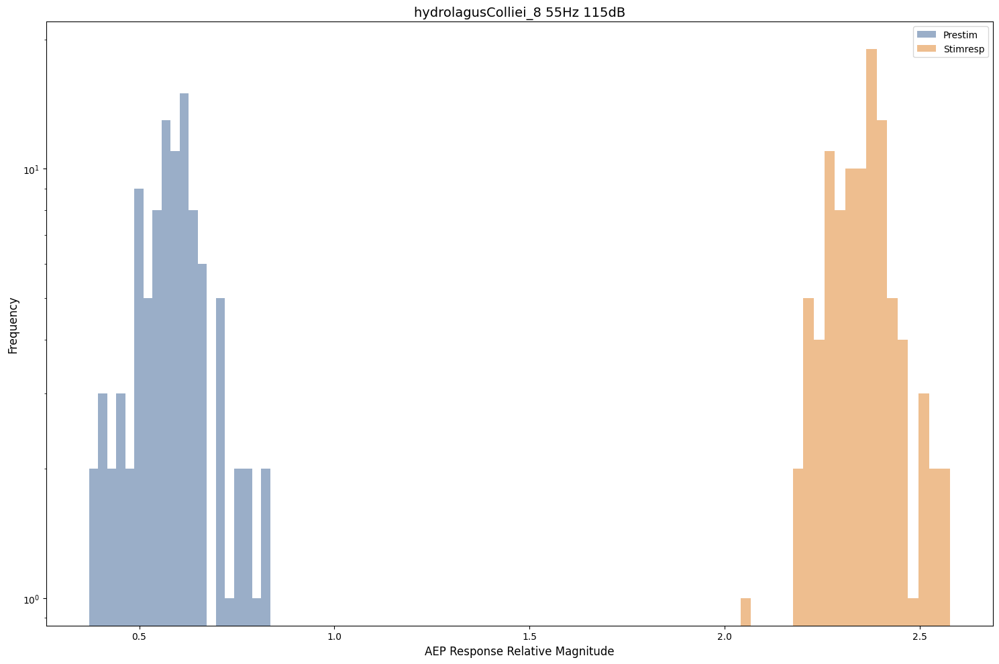

<Axes: title={'center': 'hydrolagusColliei_8 55Hz 115dB'}, xlabel='AEP Response Relative Magnitude', ylabel='Frequency'>

In [ ]:
plot_doub_freq_hist(doub_freq_dict, subjid, 'SNR', coord[0], coord[1], 20, 0)

(974, 11026)
[107. 108. 109. 110. 111. 112. 113.]
(11026,)
[ 64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 114. 115. 116. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.]
100
(488, 11026)
[107. 108. 109. 110. 111. 112. 113.]
(11026,)
[ 64.  65.  66.  67.  68.  69.  70.  71.  72.  73.  74.  75.  76.  77.
  78.  79.  80.  81.  82.  83.  84.  85.  86.  87.  88.  89.  90.  91.
  92.  93.  94.  95.  96.  97.  98.  99. 100. 101. 102. 103. 104. 105.
 106. 114. 115. 116. 124. 125. 126. 127. 128. 129. 130. 131. 132. 133.
 134. 135. 136. 137. 138. 139. 140. 141. 142. 143. 144. 145. 146. 147.
 148. 149. 150. 151. 152. 153. 154. 155. 156. 157. 158. 159. 160.]
100
(195, 11026)
[107. 108. 109. 1

(<Figure size 4000x4000 with 80 Axes>, GridSpec(10, 8))

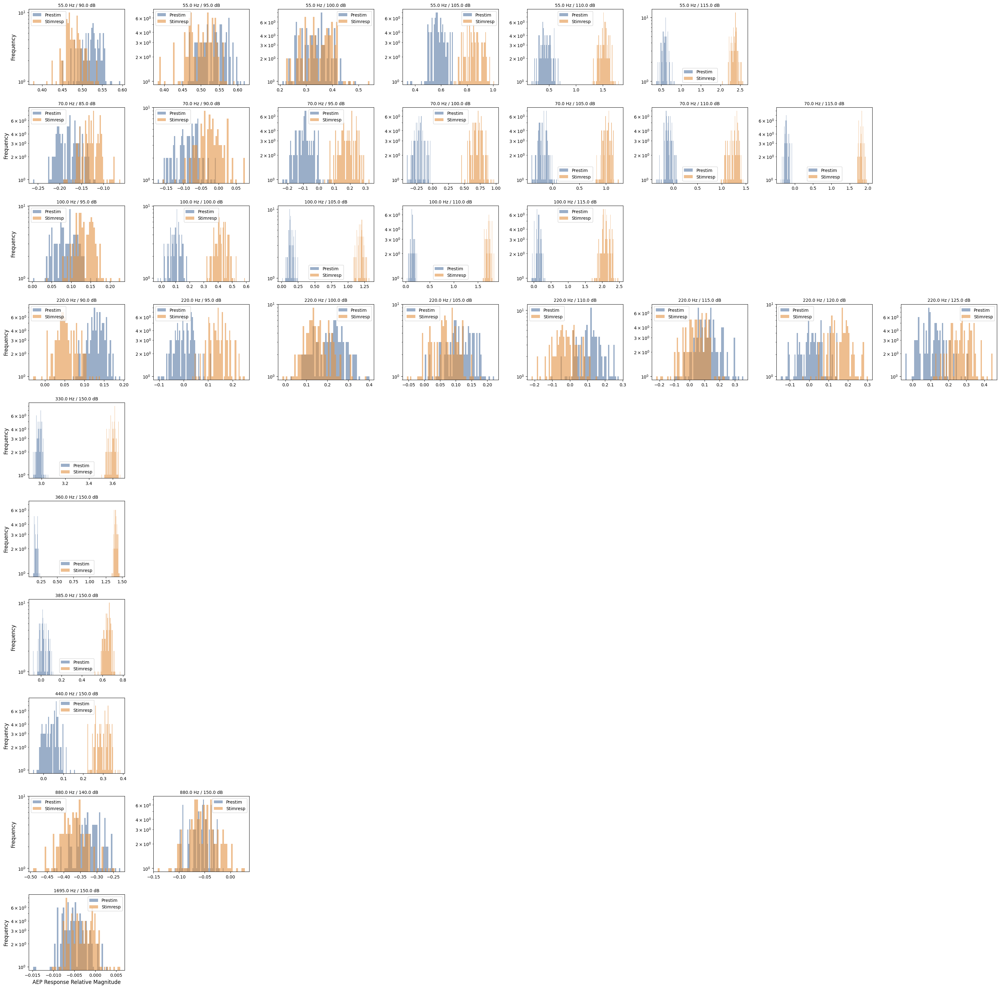

In [ ]:
Plotter(eegdataset).plot_doub_freq_hist_by_frequency_rows()